# Descrtiption 

Features in the data are computed from a digitized image of a fine needle aspirate (FNA) of a breast mass.

Attribute Information:
    
ID number

Diagnosis (M = malignant, B = benign)

The remaining (3-32)

Ten real-valued features are computed for each cell nucleus:
    
radius (mean of distances from center to points on the perimeter)

texture (standard deviation of gray-scale values)

Perimeter

Area

smoothness (local variation in radius lengths)

compactness (perimeter^2 / area - 1.0)

concavity (severity of concave portions of the contour)

concave points (number of concave portions of the contour)

Symmetry

fractal dimension ("coastline approximation" - 1)

The mean, standard error and "worst" or largest (mean of the three largest values) of these features were computed for each image, resulting in 30 features. For instance, field 3 is Mean Radius, field 13 is Radius SE, field 23 is Worst Radius. All feature values are recorded with four significant digits.


In [2]:
#import liberaries
%matplotlib inline
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from scipy.stats import norm
import seaborn as sns # visualization

plt.rcParams['figure.figsize'] = (15,8) 
plt.rcParams['axes.titlesize'] = 'large'

In [3]:
#load data
data= pd.read_csv(r"C:/Users/Smegn/Documents/GitHub/Breast-Cancer/data/data.csv")

# Cleaning

In [6]:
print(data.shape)

data.head()

(569, 33)


,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [7]:

data.describe()

,id,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
count,5.690000e+02,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,0.0
mean,3.037183e+07,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946,NaN
std,1.250206e+08,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061,NaN
min,8.670000e+03,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040,NaN
25%,8.692180e+05,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460,NaN
50%,9.060240e+05,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040,NaN
75%,8.813129e+06,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080,NaN
max,9.113205e+08,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500,NaN


In [8]:
data.isnull().sum()

id                           0
diagnosis                    0
radius_mean                  0
texture_mean                 0
perimeter_mean               0
area_mean                    0
smoothness_mean              0
compactness_mean             0
concavity_mean               0
concave points_mean          0
symmetry_mean                0
fractal_dimension_mean       0
radius_se                    0
texture_se                   0
perimeter_se                 0
area_se                      0
smoothness_se                0
compactness_se               0
concavity_se                 0
concave points_se            0
symmetry_se                  0
fractal_dimension_se         0
radius_worst                 0
texture_worst                0
perimeter_worst              0
area_worst                   0
smoothness_worst             0
compactness_worst            0
concavity_worst              0
concave points_worst         0
symmetry_worst               0
fractal_dimension_worst      0
Unnamed:

In [15]:
print(data.columns)

Index(['id', 'diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst', 'Unnamed: 32'],
      dtype='object')


In [10]:
#to check each and every row contains information of a cancerous cell is unique
data['id'].nunique()



569

From the diagnosis column, we can see how many of them are begign(B) and malign(M) where B referes  
the cells that are safe from cancer and M refers to Malign which means the cell is very much dangerous and venomous 
that can lead to breast cancer. So we need to train the data in such a way that it can predict the status of the 
cells that whether they are M(malign) or B(Benign).

In [11]:
# checking the different values contained in the diagnosis column
#we have 212 M and 357 B cells.

data['diagnosis'].value_counts()

B    357
M    212
Name: diagnosis, dtype: int64

In [56]:
#Drop the column with all missing values (na, NAN, NaN)
#NOTE: This drops the column Unnamed: 32 column
data = data.dropna(axis=1)
data.columns

Index(['id', 'diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')

# Pre-processing and visualizing 

frequency of cancer diagnosis

In [69]:
data.diagnosis.value_counts(normalize=True)

B    0.627417
M    0.372583
Name: diagnosis, dtype: float64

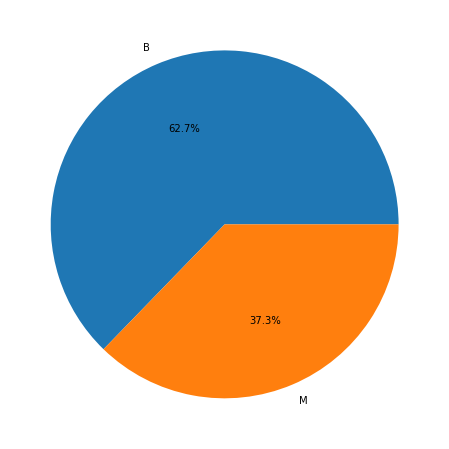

In [57]:
#graphical
colors = ["#1f77b4", "#ff7f0e"]

group_by_diag = data.groupby("diagnosis").count().reset_index()
sizes = group_by_diag['id']
labels = group_by_diag['diagnosis']
plt.pie(sizes, labels = labels, colors = colors,autopct='%1.1f%%')
plt.show()

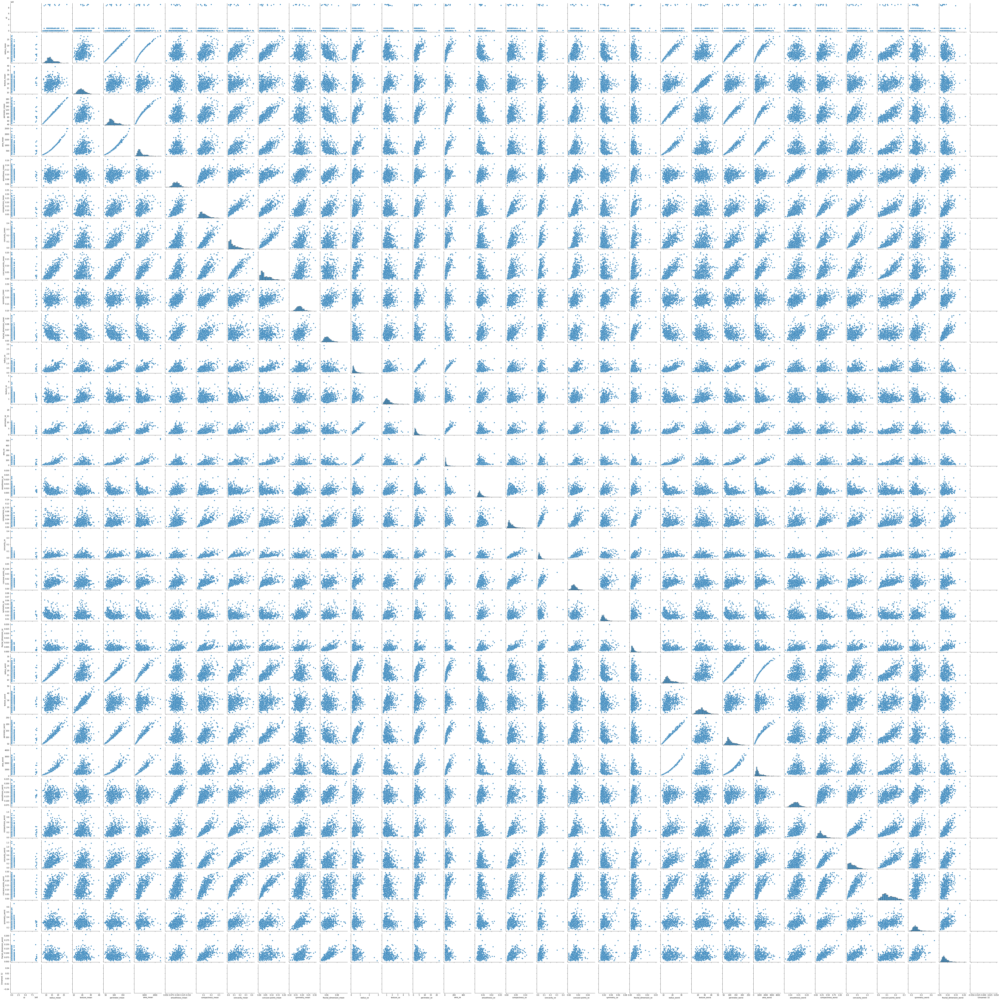

In [13]:
#to see which cells have greater radius.
# plotting the pairplot helps to visualize the relationship between two variables, where the variables can be continuous.

sns.pairplot(data)

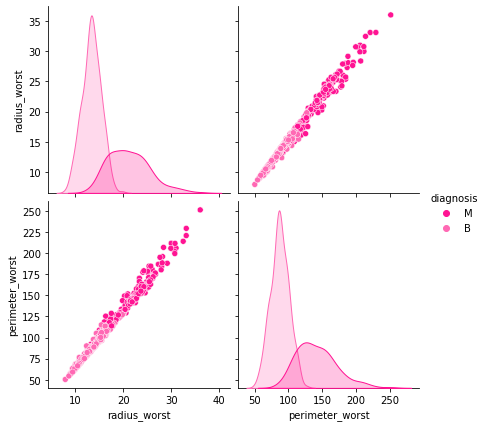

In [58]:
#for example
sns.pairplot(data, vars=["radius_worst", "perimeter_worst"],
             palette=sns.color_palette(['#FF1493', '#FF69B4']), hue='diagnosis', height=3)
plt.show()

In [59]:
#Visualise distribution of data via histograms
data.columns

Index(['id', 'diagnosis', 'radius_mean', 'texture_mean', 'perimeter_mean',
       'area_mean', 'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst'],
      dtype='object')

area_worst num must be 1 <= num <= 25, not 26


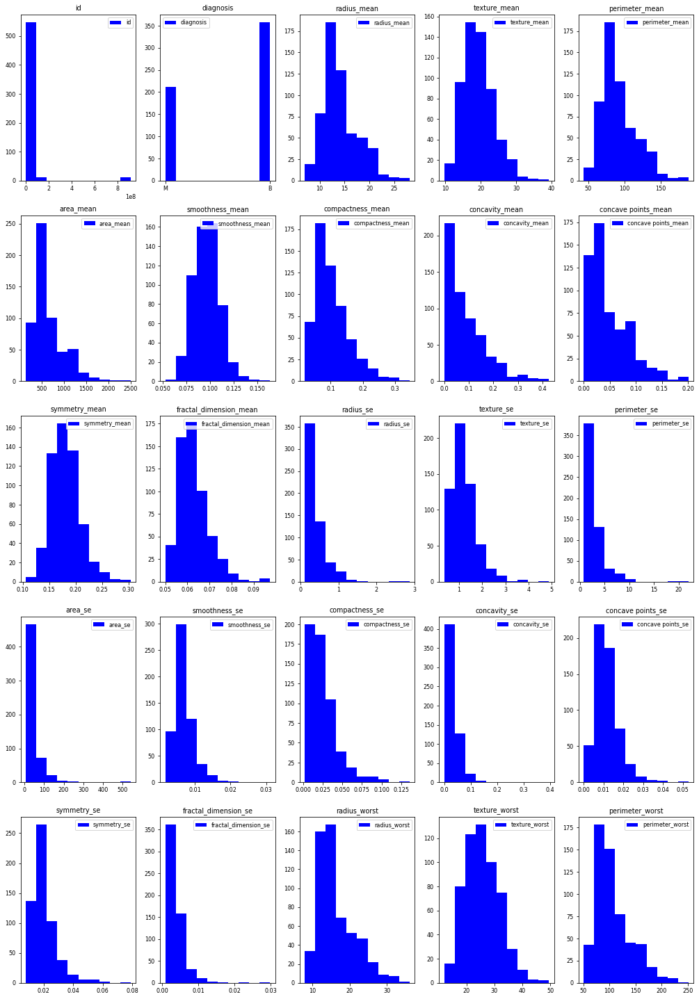

In [68]:
plt.figure(figsize=(14,20))
try:
    for i, col in enumerate(data.columns.to_list()):
        plt.subplot(5, 5, i + 1)
        plt.hist(data[col], label=col,color='blue')
        plt.legend()
        plt.title(col)
        plt.tight_layout()
except Exception as e:
    print(col,e)
plt.savefig("distr.png")

Atributes: concavity and concavity_point may have an exponential distribution.
Also, the texture, smooth and symmetry attributes may have a Gaussian or nearly Gaussian distribution. 
So it indicates us as an input variables for our machine learning techniques because  many of them assume a Gaussian univariate distribution as input variables.

In [36]:
#density plots to understand patterns in the data

In [72]:
df=data.groupby('diagnosis')

In [62]:
df.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,842302,M,17.990,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.147100,...,25.380,17.33,184.60,2019.0,0.16220,0.66560,0.71190,0.26540,0.4601,0.11890
1,842517,M,20.570,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.070170,...,24.990,23.41,158.80,1956.0,0.12380,0.18660,0.24160,0.18600,0.2750,0.08902
2,84300903,M,19.690,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.127900,...,23.570,25.53,152.50,1709.0,0.14440,0.42450,0.45040,0.24300,0.3613,0.08758
3,84348301,M,11.420,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.105200,...,14.910,26.50,98.87,567.7,0.20980,0.86630,0.68690,0.25750,0.6638,0.17300
4,84358402,M,20.290,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.104300,...,22.540,16.67,152.20,1575.0,0.13740,0.20500,0.40000,0.16250,0.2364,0.07678
19,8510426,B,13.540,14.36,87.46,566.3,0.09779,0.08129,0.06664,0.047810,...,15.110,19.26,99.70,711.2,0.14400,0.17730,0.23900,0.12880,0.2977,0.07259
20,8510653,B,13.080,15.71,85.63,520.0,0.10750,0.12700,0.04568,0.031100,...,14.500,20.49,96.09,630.5,0.13120,0.27760,0.18900,0.07283,0.3184,0.08183
21,8510824,B,9.504,12.44,60.34,273.9,0.10240,0.06492,0.02956,0.020760,...,10.230,15.66,65.13,314.9,0.13240,0.11480,0.08867,0.06227,0.2450,0.07773
37,854941,B,13.030,18.42,82.61,523.8,0.08983,0.03766,0.02562,0.029230,...,13.300,22.81,84.46,545.9,0.09701,0.04619,0.04833,0.05013,0.1987,0.06169
46,85713702,B,8.196,16.84,51.71,201.9,0.08600,0.05943,0.01588,0.005917,...,8.964,21.96,57.26,242.2,0.12970,0.13570,0.06880,0.02564,0.3105,0.07409


In [63]:
df.describe()

id                                                          \
           count          mean           std     min       25%       50%   
diagnosis                                                                  
B          357.0  2.654382e+07  1.167397e+08  8913.0  874662.0  908916.0   
M          212.0  3.681805e+07  1.378965e+08  8670.0  861345.0  895366.5   

                                   radius_mean             ... symmetry_worst  \
                  75%          max       count       mean  ...            75%   
diagnosis                                                  ...                  
B          8812816.00  911320502.0       357.0  12.146524  ...       0.298300   
M          8911289.75  911296202.0       212.0  17.462830  ...       0.359225   

                  fractal_dimension_worst                               \
              max                   count      mean       std      min   
diagnosis                                                                
B          0.4228                   357.0  0.079442  0.013804  0.05521   
M          0.6638                   212.0  0.091530  0.021553  0.05504   

                                                
                25%      50%       75%     max  
diagnosis                                       
B          0.070090  0.07712  0.085410  0.1486  
M          0.076302  0.08760  0.102625  0.2075  

[2 rows x 248 columns]

diagnosis
B    AxesSubplot(0.125,0.125;0.775x0.755)
M    AxesSubplot(0.125,0.125;0.775x0.755)
dtype: object

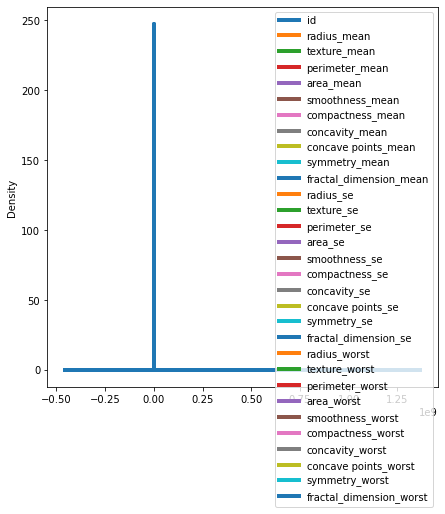

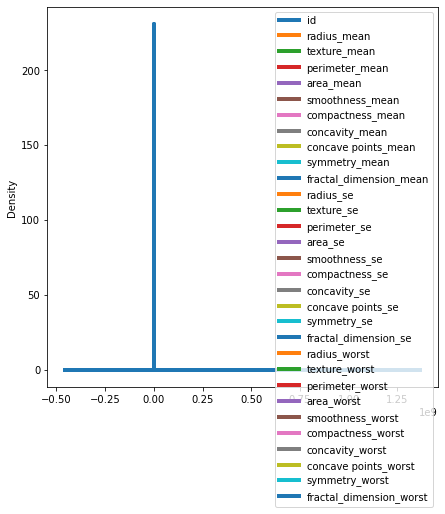

In [65]:
# multiple density plot 
df.plot.density(figsize = (7, 7),
                       linewidth = 4)
  

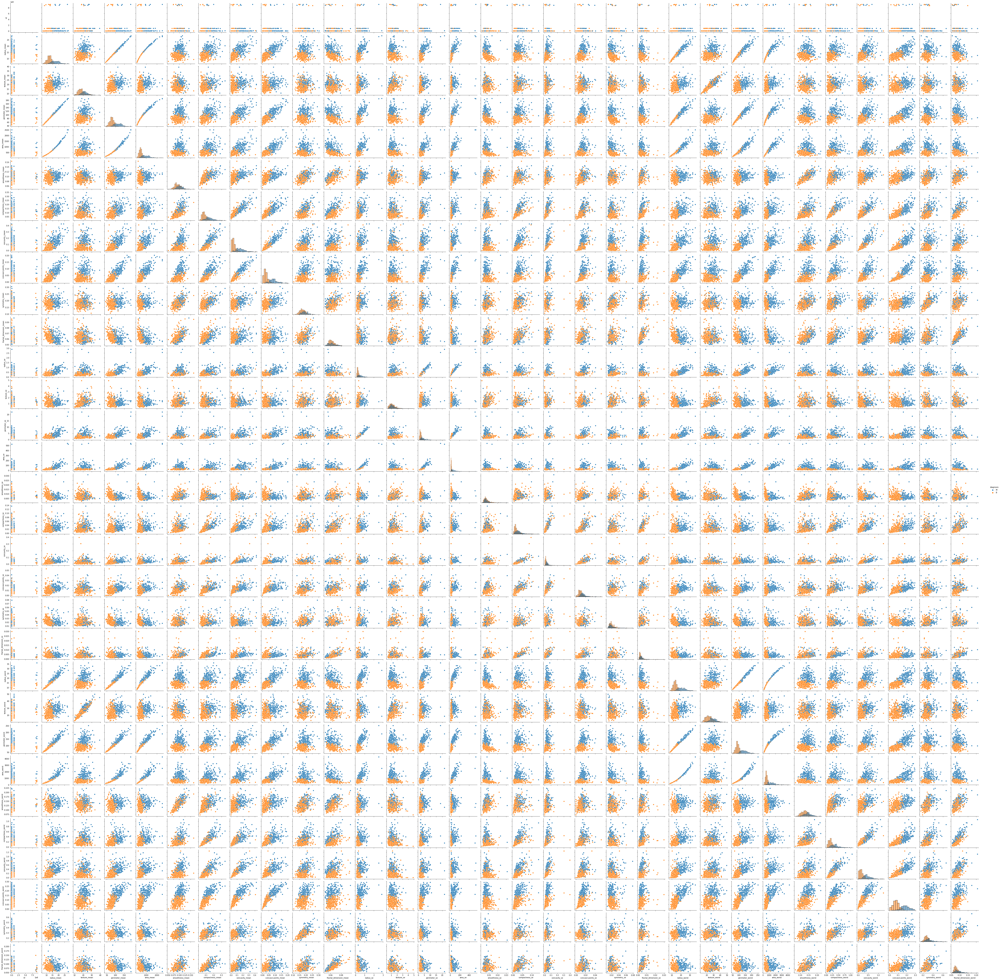

In [73]:
sns.pairplot(data, hue='diagnosis', diag_kind='hist')

Outlier detaction using box plot

<AxesSubplot:>

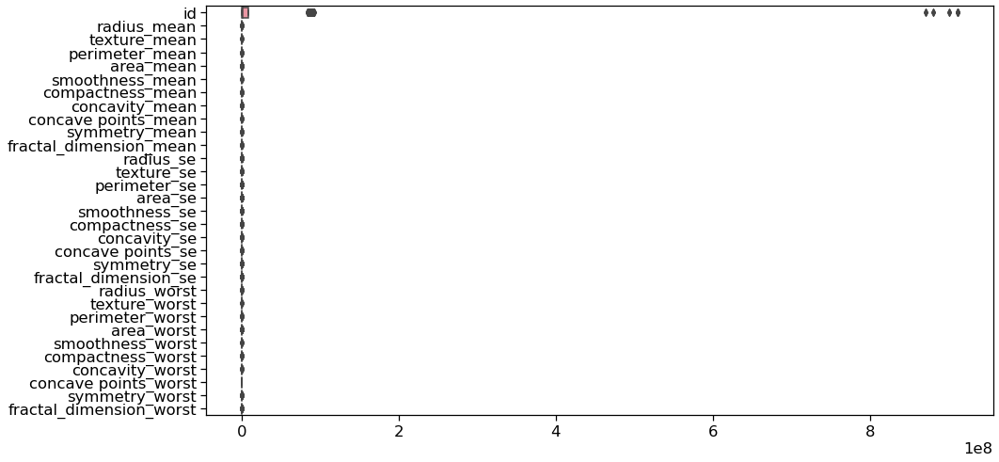

In [83]:
 sns.boxplot(data=data, orient='h')

In [5]:
#data frame with out targate attribute 
df_feature=data.drop(data.columns[1], axis=1)
df_feature.columns

Index(['id', 'radius_mean', 'texture_mean', 'perimeter_mean', 'area_mean',
       'smoothness_mean', 'compactness_mean', 'concavity_mean',
       'concave points_mean', 'symmetry_mean', 'fractal_dimension_mean',
       'radius_se', 'texture_se', 'perimeter_se', 'area_se', 'smoothness_se',
       'compactness_se', 'concavity_se', 'concave points_se', 'symmetry_se',
       'fractal_dimension_se', 'radius_worst', 'texture_worst',
       'perimeter_worst', 'area_worst', 'smoothness_worst',
       'compactness_worst', 'concavity_worst', 'concave points_worst',
       'symmetry_worst', 'fractal_dimension_worst', 'Unnamed: 32'],
      dtype='object')

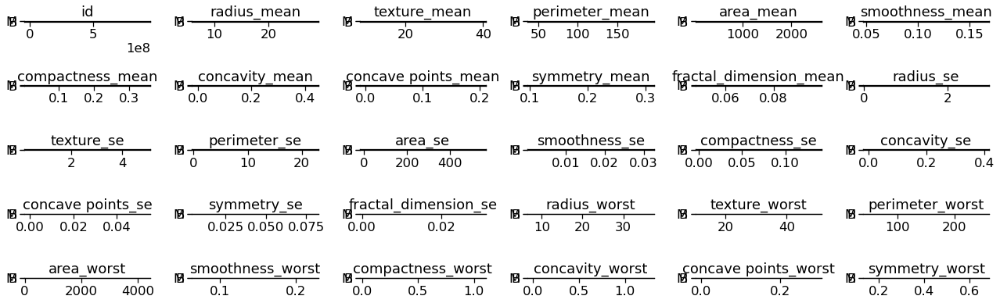

In [97]:
# create a grid of plots, with 5 rows and 6 columns
# and place it on a canvas 18 (virtual) inches whide and 6 inches high
fig, axes = plt.subplots(5, 6, figsize=(18, 6))
# for each column (and with one axis after another)
for c, ax in zip(df_feature.columns, axes.ravel()):
    # create a box-plot grouped by the target variabel
    data[[c, 'diagnosis']].boxplot(vert=False, by='diagnosis', ax=ax)
    # remove the x-axis label
    ax.set_xlabel("")
# remove the figure title
plt.suptitle("")
# fit everything nicely on the plot
plt.tight_layout()

# Bivariate/Multivariate Analysis


Correlation Plot 

In [25]:
# creation of correlation matrix
corrM = data.corr()
corrM 

,id,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
id,1.000000,0.074626,0.099770,0.073159,0.096893,-0.012968,0.000096,0.050080,0.044158,-0.022114,...,0.064720,0.079986,0.107187,0.010338,-0.002968,0.023203,0.035174,-0.044224,-0.029866,NaN
radius_mean,0.074626,1.000000,0.323782,0.997855,0.987357,0.170581,0.506124,0.676764,0.822529,0.147741,...,0.297008,0.965137,0.941082,0.119616,0.413463,0.526911,0.744214,0.163953,0.007066,NaN
texture_mean,0.099770,0.323782,1.000000,0.329533,0.321086,-0.023389,0.236702,0.302418,0.293464,0.071401,...,0.912045,0.358040,0.343546,0.077503,0.277830,0.301025,0.295316,0.105008,0.119205,NaN
perimeter_mean,0.073159,0.997855,0.329533,1.000000,0.986507,0.207278,0.556936,0.716136,0.850977,0.183027,...,0.303038,0.970387,0.941550,0.150549,0.455774,0.563879,0.771241,0.189115,0.051019,NaN
area_mean,0.096893,0.987357,0.321086,0.986507,1.000000,0.177028,0.498502,0.685983,0.823269,0.151293,...,0.287489,0.959120,0.959213,0.123523,0.390410,0.512606,0.722017,0.143570,0.003738,NaN
smoothness_mean,-0.012968,0.170581,-0.023389,0.207278,0.177028,1.000000,0.659123,0.521984,0.553695,0.557775,...,0.036072,0.238853,0.206718,0.805324,0.472468,0.434926,0.503053,0.394309,0.499316,NaN
compactness_mean,0.000096,0.506124,0.236702,0.556936,0.498502,0.659123,1.000000,0.883121,0.831135,0.602641,...,0.248133,0.590210,0.509604,0.565541,0.865809,0.816275,0.815573,0.510223,0.687382,NaN
concavity_mean,0.050080,0.676764,0.302418,0.716136,0.685983,0.521984,0.883121,1.000000,0.921391,0.500667,...,0.299879,0.729565,0.675987,0.448822,0.754968,0.884103,0.861323,0.409464,0.514930,NaN
concave points_mean,0.044158,0.822529,0.293464,0.850977,0.823269,0.553695,0.831135,0.921391,1.000000,0.462497,...,0.292752,0.855923,0.809630,0.452753,0.667454,0.752399,0.910155,0.375744,0.368661,NaN
symmetry_mean,-0.022114,0.147741,0.071401,0.183027,0.151293,0.557775,0.602641,0.500667,0.462497,1.000000,...,0.090651,0.219169,0.177193,0.426675,0.473200,0.433721,0.430297,0.699826,0.438413,NaN


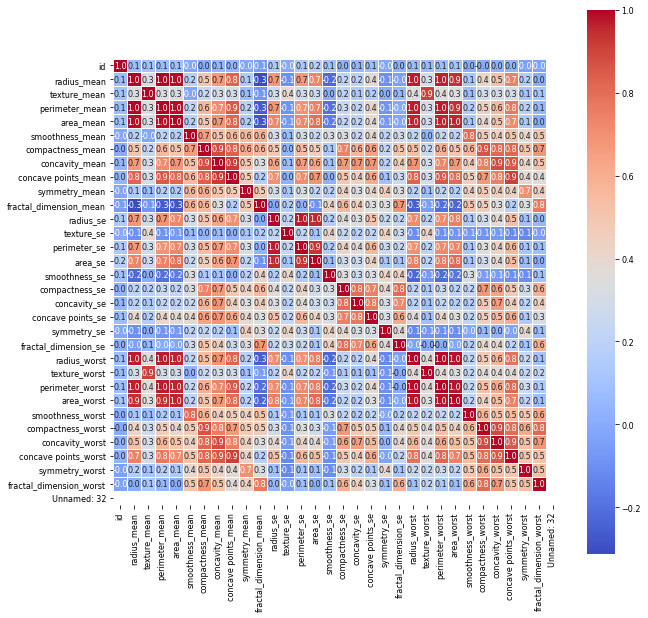

In [34]:
f,ax = plt.subplots(figsize=(10,10))
sns.heatmap(corrM, cbar = True,  square = True, annot = True, fmt= '.1f', 
            xticklabels= True, yticklabels= True
            ,cmap="coolwarm", linewidths=.8, ax=ax);
plt.savefig("corr.png")

In [38]:
breast_cancer = data.drop('id', axis=1)
 
corrM = breast_cancer.corr()
 
print(corrM)

                         radius_mean  texture_mean  perimeter_mean  area_mean  \
radius_mean                 1.000000      0.323782        0.997855   0.987357   
texture_mean                0.323782      1.000000        0.329533   0.321086   
perimeter_mean              0.997855      0.329533        1.000000   0.986507   
area_mean                   0.987357      0.321086        0.986507   1.000000   
smoothness_mean             0.170581     -0.023389        0.207278   0.177028   
compactness_mean            0.506124      0.236702        0.556936   0.498502   
concavity_mean              0.676764      0.302418        0.716136   0.685983   
concave points_mean         0.822529      0.293464        0.850977   0.823269   
symmetry_mean               0.147741      0.071401        0.183027   0.151293   
fractal_dimension_mean     -0.311631     -0.076437       -0.261477  -0.283110   
radius_se                   0.679090      0.275869        0.691765   0.732562   
texture_se                 -

##corrM.abs()##

The abs() function is used to return the absolute value of a number.

## high_correlation.unstack()##

The unstack() function in a dataframe unstacks the row to columns.

###
high_correlation_unstack.sort_values(ascending=False)##

The sort.values() function will sort the values in ascending or descending order.
Also, we will print the high correlation between 30 and 40 because the first the 29 values will have a correlation of
1.000000.

In [39]:
high_correlation = corrM.abs()
high_correlation_unstack = high_correlation.unstack()
high_correlation_sort = high_correlation_unstack.sort_values(ascending=False)
 
print(high_correlation_sort[30:40])

radius_mean      perimeter_mean     0.997855
perimeter_mean   radius_mean        0.997855
perimeter_worst  radius_worst       0.993708
radius_worst     perimeter_worst    0.993708
radius_mean      area_mean          0.987357
area_mean        radius_mean        0.987357
perimeter_mean   area_mean          0.986507
area_mean        perimeter_mean     0.986507
radius_worst     area_worst         0.984015
area_worst       radius_worst       0.984015
dtype: float64


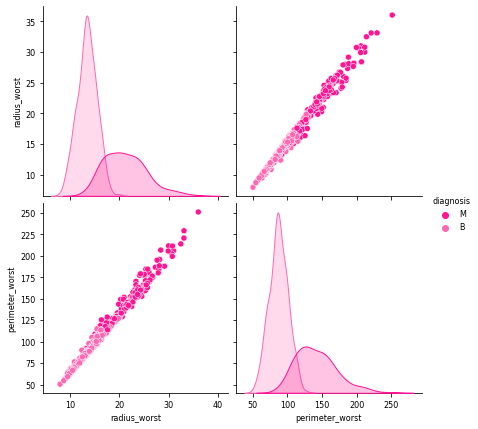

<Figure size 1080x576 with 0 Axes>

In [41]:
sns.pairplot(breast_cancer, vars=["radius_worst", "perimeter_worst"],
             palette=sns.color_palette(['#FF1493', '#FF69B4']), hue='diagnosis', height=3)
plt.show()
plt.savefig("sample_corr.jpg")

In [42]:
df_mean = data[data.columns[:11]]
df_se = data.drop(data.columns[1:11], axis=1)
df_se = df_se.drop(df_se.columns[11:], axis=1)
df_worst = data.drop(data.columns[1:21], axis=1)

In [43]:
dfM = data[data['diagnosis'] == 1]
dfB = data[data['diagnosis'] == 0]
df_mean_cols = list(data.columns[1:11])
df_se_cols = list(data.columns[11:21])
df_worst_cols = list(data.columns[21:])
df_mean_cols

['diagnosis',
 'radius_mean',
 'texture_mean',
 'perimeter_mean',
 'area_mean',
 'smoothness_mean',
 'compactness_mean',
 'concavity_mean',
 'concave points_mean',
 'symmetry_mean']

# Correlation with Diagnosis:

In [ ]:
plt.rcParams.update({'font.size': 8})
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(8, 10))
axes = axes.ravel()
for idx, ax in enumerate(axes):
    ax.figure
    binwidth = (max(data[df_mean_cols[idx]]) - min(data[df_mean_cols[idx]])) / 50
    ax.hist([dfM[df_mean_cols[idx]], dfB[df_mean_cols[idx]]],
            bins=np.arange(min(data[df_mean_cols[idx]]), max(data[df_mean_cols[idx]]) + binwidth, binwidth), alpha=0.5,
            stacked=True, label=['M', 'B'], color=['b', 'g'])
    ax.legend(loc='upper right')
    ax.set_title(df_mean_cols[idx])
plt.tight_layout()
plt.show()

# Perform feature extraction and scaling 


Feature selection is the process of reducing the number of input variables when developing a predictive model.